# Exploratory Analysis - Changes in Trend

In [2]:
# Data analysis
import geopandas as gpd
import numpy as np
import pandas as pd
import json

# APIs
import requests

# Plotting
import seaborn as sns
from matplotlib import pyplot as plt
import holoviews as hv
import hvplot.pandas
import cenpy
from matplotlib.ticker import MaxNLocator

C:\ProgramData\mambaforge\envs\musa-550-fall-2023\lib\site-packages\libpysal\cg\alpha_shapes.py:39: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def nb_dist(x, y):
C:\ProgramData\mambaforge\envs\musa-550-fall-2023\lib\site-packages\libpysal\cg\alpha_shapes.py:165: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def get_faces(triangle):
C:\ProgramData\mambaforge\e

In [4]:
pd.options.display.max_columns = 999
pd.options.display.max_colwidth = None

### 1. Looking at the Jobs Trend prior and during Pandemic

**In this step, we use BLS data (from 2001 to 2021) to explore the jobs change in NYC.**

In [5]:
api_key = 'bf9f940bdb914a86afd2452b1a655b5e'
series_id = 'SMU36356140000000001'  # Replace with the specific series ID for total employment
start_year = 2001
end_year = 2021

url = f'https://api.bls.gov/publicAPI/v2/timeseries/data/{series_id}'
headers = {'Content-type': 'application/json'}
params = {'api_key': api_key, 'startyear': start_year, 'endyear': end_year}

response = requests.get(url, headers=headers, params=params)
data = response.json()

In [6]:
api_key = 'bf9f940bdb914a86afd2452b1a655b5e'
series_id = 'SMU36356140000000001'  # Replace with the specific series ID for total employment
start_year = 2011
end_year = 2021

url = f'https://api.bls.gov/publicAPI/v2/timeseries/data/{series_id}'
headers = {'Content-type': 'application/json'}
params = {'api_key': api_key, 'startyear': start_year, 'endyear': end_year}

response = requests.get(url, headers=headers, params=params)
data2 = response.json()

In [7]:
# Extract relevant information from the response
series_data1 = data['Results']['series'][0]['data']
series_data2 = data2['Results']['series'][0]['data']

# Create a DataFrame1
df1 = pd.DataFrame(series_data1)
df1.head()

,year,period,periodName,value,footnotes
0,2010,M12,December,6209.5,[{}]
1,2010,M11,November,6184.7,[{}]
2,2010,M10,October,6148.7,[{}]
3,2010,M09,September,6070.2,[{}]
4,2010,M08,August,6048.5,[{}]


In [8]:
# Create a DataFrame2
df2 = pd.DataFrame(series_data2)
df2.head()

,year,period,periodName,value,footnotes
0,2020,M12,December,6608.7,[{}]
1,2020,M11,November,6607.4,[{}]
2,2020,M10,October,6560.2,[{}]
3,2020,M09,September,6413.1,[{}]
4,2020,M08,August,6287.2,[{}]


In [9]:
df = pd.concat([df1, df2], ignore_index=True)

In [10]:
# Convert the 'year' column to numeric
df['year'] = pd.to_numeric(df['year'])
df['value'] = pd.to_numeric(df['value'])
df = df.rename(columns={'value': 'job_num'})
df.head()

,year,period,periodName,job_num,footnotes
0,2010,M12,December,6209.5,[{}]
1,2010,M11,November,6184.7,[{}]
2,2010,M10,October,6148.7,[{}]
3,2010,M09,September,6070.2,[{}]
4,2010,M08,August,6048.5,[{}]


In [11]:
# Group by year and calculate the total number of jobs for each year
job_df = df.groupby('year')['job_num'].sum().reset_index()
# Print the result DataFrame
job_df

,year,job_num
0,2001,73463.9
1,2002,71899.8
2,2003,71360.7
3,2004,71838.5
4,2005,72674.4
5,2006,73617.2
6,2007,74776.2
7,2008,75244.3
8,2009,72913.5
9,2010,73031.6


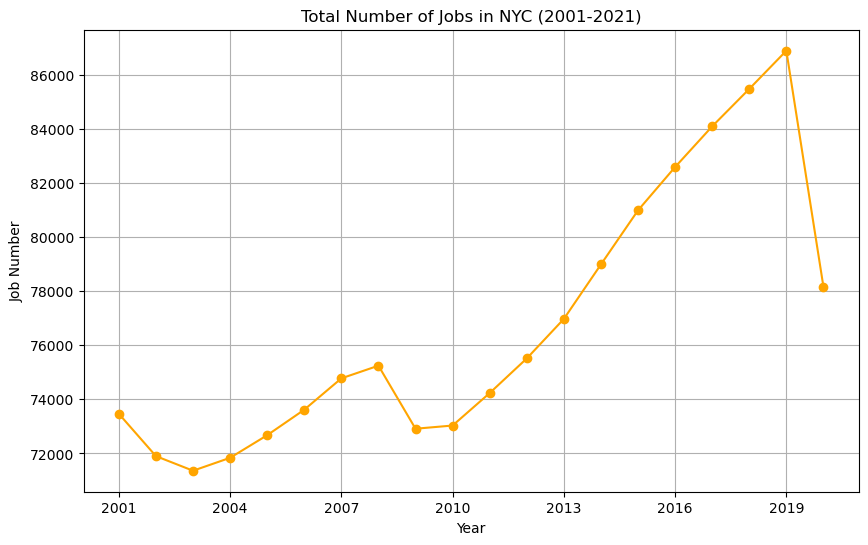

In [12]:
# Create a line graph with integer x-axis labels
plt.figure(figsize=(10, 6))
plt.plot(job_df['year'], job_df['job_num'], marker='o', linestyle='-', color='orange')
plt.title('Total Number of Jobs in NYC (2001-2021)')
plt.xlabel('Year')
plt.ylabel('Job Number')

# Set x-axis ticks to integer values
plt.gca().xaxis.set_major_locator(MaxNLocator(integer=True))

plt.grid(True)
plt.show() 

**Insight1: To explore the employment trend in recent 20 years, we used API for Bureau of Labor Statistics to see the total number of jobs in NYC Metro Region. It shows very clearly that the number of jobs has dropped significantly in 2008 (predicted to be an economic crisis) and 2019 (pendamic). However, from 2021 onwards, there are signs of economic recovery.**

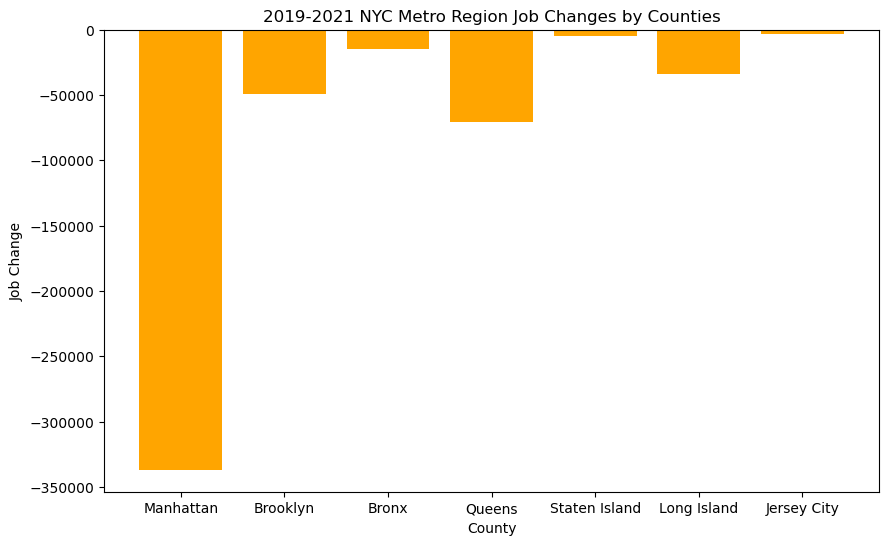

In [76]:
# Create the county_job DataFrame
data = {'county': ['Manhattan', 'Brooklyn', 'Bronx', 'Queens', 'Staten Island', 'Long Island', 'Jersey City'],
        'job_change': [-336907, -49298, -14721, -70690, -4905, -33898, -3394]}

county_job = pd.DataFrame(data)

# Create a bar graph
plt.figure(figsize=(10, 6))
plt.bar(county_job['county'], county_job['job_change'], color='orange')
plt.xlabel('County')
plt.ylabel('Job Change')
plt.title('2019-2021 NYC Metro Region Job Changes by Counties')
plt.show()

**Insight2: From 2019 to 2022, all counties in NYC metro region suffer a decrease in work position. The entire region loses 513,813 jobs. 65.6% job decrease is in Manhatten, the economic core of the region.**

### 2. Looking at the Population Trend prior and during Pandemic

**In this step, we use  ACSDT5Y2021ACS and ACSDT5Y2019 data to explore the jobs change in NYC metro region.**

In [13]:
acs21 = cenpy.remote.APIConnection("ACSDT5Y2021")
acs19 = cenpy.remote.APIConnection("ACSDT5Y2019")

In [14]:
variables = [
    "NAME",
    "B01001_001E", # total population
    "B07013_001E", # Total:!!Householder
    "B07013_002E", # Total:!!Householder lived in owner-occupied housing units
    "B07013_003E", # Total:!!Householder lived in renter-occupied housing units
    "B25077_001E", # Median value (dollars)    
]

In [15]:
ny_counties = ['061', '047', '005', '081', '085', '059']

In [16]:
ny_data_21 = []

for county in ny_counties:
    county_data = acs21.query(
        cols=variables,
        geo_unit="tract:*",
        geo_filter={"state": '36', "county": county},
    )
    ny_data_21.append(county_data)

# Adding data for Jersey City
nj_data_21 = acs21.query(
    cols=variables,
    geo_unit="tract:*",
    geo_filter={"state": '34', "county": '017'},
)

ny_data_21.append(nj_data_21)

acsdata21 = pd.concat(ny_data_21, ignore_index=True)

# Rename columns
acsdata21 = acsdata21.rename(columns={
    'B01001_001E': '21 population',
    "B07013_001E": '21 total householder',
    'B07013_002E': '21 owner householder',
    'B07013_003E': '21 renter householder',
    'B25077_001E': '21 median housing value',
})

acsdata21['GEOID'] = acsdata21['state'] + acsdata21['county'] + acsdata21['tract']

acsdata21.head()

,NAME,21 population,21 total householder,21 owner householder,21 renter householder,21 median housing value,state,county,tract,GEOID
0,"Census Tract 1, New York County, New York",0,0,0,0,-666666666,36,061,000100,36061000100
1,"Census Tract 2.01, New York County, New York",2740,2659,0,2659,-666666666,36,061,000201,36061000201
2,"Census Tract 2.02, New York County, New York",6789,6425,1501,4924,667500,36,061,000202,36061000202
3,"Census Tract 5, New York County, New York",0,0,0,0,-666666666,36,061,000500,36061000500
4,"Census Tract 6, New York County, New York",10732,10529,498,10031,776000,36,061,000600,36061000600


In [17]:
ny_data_19 = []

for county in  ny_counties:
    county_data = acs19.query(
        cols=variables,
        geo_unit="tract:*",
        geo_filter={"state": '36', "county": county},
    )
    ny_data_19.append(county_data)

# Adding data for Jersey City
nj_data_19 = acs19.query(
    cols=variables,
    geo_unit="tract:*",
    geo_filter={"state": '34', "county": '017'},
)

ny_data_19.append(nj_data_19)

acsdata19 = pd.concat(ny_data_19, ignore_index=True)

# Rename columns
acsdata19 = acsdata19.rename(columns={
    'B01001_001E': '19 population',
    'B07013_001E': '19 total householder',
    'B07013_002E': '19 owner householder',
    'B07013_003E': '19 renter householder',
    'B25077_001E': '19 median housing value',
})

acsdata19['GEOID'] = acsdata19['state'] + acsdata19['county'] + acsdata19['tract']

acsdata19.head()

,NAME,19 population,19 total householder,19 owner householder,19 renter householder,19 median housing value,state,county,tract,GEOID
0,"Census Tract 255, New York County, New York",5999,5367,104,5263,789300,36,061,025500,36061025500
1,"Census Tract 222, New York County, New York",3369,3198,694,2504,1096400,36,061,022200,36061022200
2,"Census Tract 10.01, New York County, New York",1546,1535,983,552,677800,36,061,001001,36061001001
3,"Census Tract 7, New York County, New York",8501,8452,1997,6455,1403800,36,061,000700,36061000700
4,"Census Tract 103, New York County, New York",2065,2036,190,1846,444700,36,061,010300,36061010300


In [21]:
metro_geojson_path = 'Data_git/Geo/metro.geojson'
metro_gdf = gpd.read_file(metro_geojson_path)
metro_gdf.head()

,GEOID,COUNTYFP,geometry
0,36061001501,061,"POLYGON ((981865.515 198455.903, 981935.654 198443.874, 982041.006 198475.925, 982007.461 198481.757, 981991.382 198486.859, 981975.580 198493.419, 981972.254 198503.256, 981969.206 198512.365, 981970.593 198523.659, 981972.257 198533.860, 981980.576 198552.440, 981994.716 198567.376, 982010.242 198575.754, 982026.045 198579.396, 982042.124 198581.216, 982058.481 198581.579, 982074.838 198580.120, 982088.698 198571.375, 982103.945 198564.452, 982135.826 198556.434, 982168.817 198556.795, 982304.387 198598.682, 982561.664 198678.451, 982572.199 198681.729, 982612.121 198693.749, 982658.697 198709.777, 982700.560 198739.285, 982747.413 198754.948, 982787.335 198768.062, 982828.644 198789.190, 982867.457 198813.962, 982894.072 198835.092, 982903.221 198842.378, 983060.418 199008.140, 983026.870 198931.633, 983005.521 198876.620, 983002.468 198824.885, 983012.446 198776.429, 983025.475 198748.010, 983077.591 198686.436, 983111.689 198651.094, 983138.302 198623.768, 983149.113 198612.473, 983215.646 198552.356, 983243.645 198522.480, 983269.427 198493.332, 983332.079 198427.750, 983550.532 198193.843, 983786.456 197954.108, 983856.596 197881.241, 983910.380 197824.040, 984118.587 197602.890, 984185.679 197531.845, 984192.888 197524.194, 984286.319 197427.647, 984390.009 197321.627, 984422.448 197285.923, 984445.182 197260.420, 984478.175 197227.995, 985755.536 195899.693, 985775.500 195878.563, 985756.925 195859.252, 985742.231 195845.043, 985692.604 195797.677, 985715.619 195761.610, 985687.340 195728.454, 985669.319 195694.570, 985669.043 195685.462, 985638.546 195636.640, 985675.702 195604.581, 985729.772 195555.400, 985690.125 195506.213, 985617.208 195435.528, 985598.079 195391.079, 985311.100 195530.968, 983757.863 196113.513, 983735.406 196144.117, 983650.567 196258.519, 983582.085 196298.597, 983462.592 196450.162, 983419.620 196520.479, 983402.985 196546.347, 983380.252 196581.688, 983256.327 196779.159, 983220.009 196840.004, 983157.355 196938.740, 983125.197 197014.887, 983050.069 197155.886, 982914.506 197362.104, 982874.864 197427.321, 982834.944 197492.174, 982791.144 197555.570, 982721.837 197618.239, 982465.954 197787.306, 982294.351 197902.083, 982224.213 197948.359, 982102.789 198029.251, 981737.414 198271.930, 981865.515 198455.903))"
1,36061001600,061,"POLYGON ((984941.947 199431.109, 985056.156 199631.130, 985135.435 199783.787, 985211.387 199942.638, 985342.498 200219.170, 985517.122 200600.633, 985689.243 201029.824, 985960.911 200916.170, 986164.109 200834.940, 986406.673 200738.777, 986627.894 200651.358, 986696.090 200624.040, 986827.215 200572.319, 987035.686 200488.910, 987256.357 200392.753, 987090.357 199971.931, 986966.200 199648.392, 986959.829 199599.935, 986961.221 199553.665, 986812.902 199607.934, 986682.611 199583.511, 986430.619 199559.077, 986311.970 199547.408, 986231.576 199539.750, 986186.112 199535.739, 985926.912 199512.038, 985874.518 199504.019, 985817.134 199496.000, 985774.719 199490.168, 985731.195 199486.158, 985680.464 199482.147, 985226.376 199444.963, 984958.580 199430.380, 984941.947 199431.109))"
2,36061001800,061,"POLYGON ((985796.223 201370.479, 985808.416 201416.750, 985839.734 201512.571, 985903.476 201709.678, 985969.987 201933.382, 986004.905 202049.606, 986045.365 202186.597, 986264.908 202100.268, 986401.845 202046.723, 986604.480 201966.589, 986847.589 201871.159, 987061.593 201786.294, 987127.292 201760.434, 987267.560 201704.345, 987478.240 201620.211, 987703.337 201531.346, 987922.337 201443.938, 987753.864 200998.337, 987733.359 200941.134, 987712.299 200890.489, 987610.043 200648.195, 987474.812 200297.326, 987256.357 200392.753, 987035.686 200488.910, 986827.215 200572.319, 986696.090 200624.040, 986627.894 200651.358, 986406.673 200738.777, 986164.109 200834.940, 985960.911 200916.170, 985689.243 201029.824, 985796.223 201370.479))"
3,36061002000,061,"POLYGON ((990149.045 201586.466, 990284.254 201838.252, 990343.825 2

In [22]:
# Calculate the area and convert it to square miles
metro_gdf['area'] = metro_gdf['geometry'].to_crs(epsg=3857).area / 10**6
metro_gdf.head()

,GEOID,COUNTYFP,geometry,area
0,36061001501,061,"POLYGON ((981865.515 198455.903, 981935.654 198443.874, 982041.006 198475.925, 982007.461 198481.757, 981991.382 198486.859, 981975.580 198493.419, 981972.254 198503.256, 981969.206 198512.365, 981970.593 198523.659, 981972.257 198533.860, 981980.576 198552.440, 981994.716 198567.376, 982010.242 198575.754, 982026.045 198579.396, 982042.124 198581.216, 982058.481 198581.579, 982074.838 198580.120, 982088.698 198571.375, 982103.945 198564.452, 982135.826 198556.434, 982168.817 198556.795, 982304.387 198598.682, 982561.664 198678.451, 982572.199 198681.729, 982612.121 198693.749, 982658.697 198709.777, 982700.560 198739.285, 982747.413 198754.948, 982787.335 198768.062, 982828.644 198789.190, 982867.457 198813.962, 982894.072 198835.092, 982903.221 198842.378, 983060.418 199008.140, 983026.870 198931.633, 983005.521 198876.620, 983002.468 198824.885, 983012.446 198776.429, 983025.475 198748.010, 983077.591 198686.436, 983111.689 198651.094, 983138.302 198623.768, 983149.113 198612.473, 983215.646 198552.356, 983243.645 198522.480, 983269.427 198493.332, 983332.079 198427.750, 983550.532 198193.843, 983786.456 197954.108, 983856.596 197881.241, 983910.380 197824.040, 984118.587 197602.890, 984185.679 197531.845, 984192.888 197524.194, 984286.319 197427.647, 984390.009 197321.627, 984422.448 197285.923, 984445.182 197260.420, 984478.175 197227.995, 985755.536 195899.693, 985775.500 195878.563, 985756.925 195859.252, 985742.231 195845.043, 985692.604 195797.677, 985715.619 195761.610, 985687.340 195728.454, 985669.319 195694.570, 985669.043 195685.462, 985638.546 195636.640, 985675.702 195604.581, 985729.772 195555.400, 985690.125 195506.213, 985617.208 195435.528, 985598.079 195391.079, 985311.100 195530.968, 983757.863 196113.513, 983735.406 196144.117, 983650.567 196258.519, 983582.085 196298.597, 983462.592 196450.162, 983419.620 196520.479, 983402.985 196546.347, 983380.252 196581.688, 983256.327 196779.159, 983220.009 196840.004, 983157.355 196938.740, 983125.197 197014.887, 983050.069 197155.886, 982914.506 197362.104, 982874.864 197427.321, 982834.944 197492.174, 982791.144 197555.570, 982721.837 197618.239, 982465.954 197787.306, 982294.351 197902.083, 982224.213 197948.359, 982102.789 198029.251, 981737.414 198271.930, 981865.515 198455.903))",0.761081
1,36061001600,061,"POLYGON ((984941.947 199431.109, 985056.156 199631.130, 985135.435 199783.787, 985211.387 199942.638, 985342.498 200219.170, 985517.122 200600.633, 985689.243 201029.824, 985960.911 200916.170, 986164.109 200834.940, 986406.673 200738.777, 986627.894 200651.358, 986696.090 200624.040, 986827.215 200572.319, 987035.686 200488.910, 987256.357 200392.753, 987090.357 199971.931, 986966.200 199648.392, 986959.829 199599.935, 986961.221 199553.665, 986812.902 199607.934, 986682.611 199583.511, 986430.619 199559.077, 986311.970 199547.408, 986231.576 199539.750, 986186.112 199535.739, 985926.912 199512.038, 985874.518 199504.019, 985817.134 199496.000, 985774.719 199490.168, 985731.195 199486.158, 985680.464 199482.147, 985226.376 199444.963, 984958.580 199430.380, 984941.947 199431.109))",0.361350
2,36061001800,061,"POLYGON ((985796.223 201370.479, 985808.416 201416.750, 985839.734 201512.571, 985903.476 201709.678, 985969.987 201933.382, 986004.905 202049.606, 986045.365 202186.597, 986264.908 202100.268, 986401.845 202046.723, 986604.480 201966.589, 986847.589 201871.159, 987061.593 201786.294, 987127.292 201760.434, 987267.560 201704.345, 987478.240 201620.211, 987703.337 201531.346, 987922.337 201443.938, 987753.864 200998.337, 987733.359 200941.134, 987712.299 200890.489, 987610.043 200648.195, 987474.812 200297.326, 987256.357 200392.753, 987035.686 200488.910, 986827.215 200572.319, 986696.090 200624.040, 986627.894 200651.358, 986406.673 200738.777, 986164.109 200834.940, 985960.911 200916.170, 985689.243 201029.824, 985796.223 201370.479))",0.388537
3,36061002000,061,"POLYGON ((990149.045 201586.466, 990

In [33]:
# turning strings to numeric
acs21_gdf = metro_gdf.merge(acsdata21, on='GEOID', how='inner', suffixes=('_metro', '_acs21'))

acs21_gdf['21 population'] = pd.to_numeric(acs21_gdf['21 population'], errors='coerce')
acs21_gdf['area'] = pd.to_numeric(acs21_gdf['area'], errors='coerce')
acs21_gdf['pop_density'] = acs21_gdf['21 population'] / acs21_gdf['area']

acs21_gdf['21 owner householder'] = pd.to_numeric(acs21_gdf['21 owner householder'], errors='coerce')
acs21_gdf['21 renter householder'] = pd.to_numeric(acs21_gdf['21 renter householder'], errors='coerce')
acs21_gdf['21 total householder'] = pd.to_numeric(acs21_gdf['21 total householder'], errors='coerce')
acs21_gdf['21 median housing value'] = pd.to_numeric(acs21_gdf['21 median housing value'], errors='coerce')
acs21_gdf['own_rate'] = acs21_gdf['21 owner householder'] / acs21_gdf['21 total householder']
acs21_gdf['rent_rate'] = 1-acs21_gdf['own_rate']

acs21_gdf.head()

,GEOID,COUNTYFP,geometry,area,NAME,21 population,21 total householder,21 owner householder,21 renter householder,21 median housing value,state,county,tract,pop_density,own_rate,rent_rate
0,36061001501,061,"POLYGON ((981865.515 198455.903, 981935.654 198443.874, 982041.006 198475.925, 982007.461 198481.757, 981991.382 198486.859, 981975.580 198493.419, 981972.254 198503.256, 981969.206 198512.365, 981970.593 198523.659, 981972.257 198533.860, 981980.576 198552.440, 981994.716 198567.376, 982010.242 198575.754, 982026.045 198579.396, 982042.124 198581.216, 982058.481 198581.579, 982074.838 198580.120, 982088.698 198571.375, 982103.945 198564.452, 982135.826 198556.434, 982168.817 198556.795, 982304.387 198598.682, 982561.664 198678.451, 982572.199 198681.729, 982612.121 198693.749, 982658.697 198709.777, 982700.560 198739.285, 982747.413 198754.948, 982787.335 198768.062, 982828.644 198789.190, 982867.457 198813.962, 982894.072 198835.092, 982903.221 198842.378, 983060.418 199008.140, 983026.870 198931.633, 983005.521 198876.620, 983002.468 198824.885, 983012.446 198776.429, 983025.475 198748.010, 983077.591 198686.436, 983111.689 198651.094, 983138.302 198623.768, 983149.113 198612.473, 983215.646 198552.356, 983243.645 198522.480, 983269.427 198493.332, 983332.079 198427.750, 983550.532 198193.843, 983786.456 197954.108, 983856.596 197881.241, 983910.380 197824.040, 984118.587 197602.890, 984185.679 197531.845, 984192.888 197524.194, 984286.319 197427.647, 984390.009 197321.627, 984422.448 197285.923, 984445.182 197260.420, 984478.175 197227.995, 985755.536 195899.693, 985775.500 195878.563, 985756.925 195859.252, 985742.231 195845.043, 985692.604 195797.677, 985715.619 195761.610, 985687.340 195728.454, 985669.319 195694.570, 985669.043 195685.462, 985638.546 195636.640, 985675.702 195604.581, 985729.772 195555.400, 985690.125 195506.213, 985617.208 195435.528, 985598.079 195391.079, 985311.100 195530.968, 983757.863 196113.513, 983735.406 196144.117, 983650.567 196258.519, 983582.085 196298.597, 983462.592 196450.162, 983419.620 196520.479, 983402.985 196546.347, 983380.252 196581.688, 983256.327 196779.159, 983220.009 196840.004, 983157.355 196938.740, 983125.197 197014.887, 983050.069 197155.886, 982914.506 197362.104, 982874.864 197427.321, 982834.944 197492.174, 982791.144 197555.570, 982721.837 197618.239, 982465.954 197787.306, 982294.351 197902.083, 982224.213 197948.359, 982102.789 198029.251, 981737.414 198271.930, 981865.515 198455.903))",0.761081,"Census Tract 15.01, New York County, New York",7749,7290,4254,3036,767300,36,061,001501,10181.574978,0.583539,0.416461
1,36061001600,061,"POLYGON ((984941.947 199431.109, 985056.156 199631.130, 985135.435 199783.787, 985211.387 199942.638, 985342.498 200219.170, 985517.122 200600.633, 985689.243 201029.824, 985960.911 200916.170, 986164.109 200834.940, 986406.673 200738.777, 986627.894 200651.358, 986696.090 200624.040, 986827.215 200572.319, 987035.686 200488.910, 987256.357 200392.753, 987090.357 199971.931, 986966.200 199648.392, 986959.829 199599.935, 986961.221 199553.665, 986812.902 199607.934, 986682.611 199583.511, 986430.619 199559.077, 986311.970 199547.408, 986231.576 199539.750, 986186.112 199535.739, 985926.912 199512.038, 985874.518 199504.019, 985817.134 199496.000, 985774.719 199490.168, 985731.195 199486.158, 985680.464 199482.147, 985226.376 199444.963, 984958.580 199430.380, 984941.947 199431.109))",0.361350,"Census Tract 16, New York County, New York",8133,7950,1263,6687,668200,36,061,001600,22507.261055,0.158868,0.841132
2,36061001800,061,"POLYGON ((985796.223 201370.479, 985808.416 201416.750, 985839.734 201512.571, 985903.476 201709.678, 985969.987 201933.382, 986004.905 202049.606, 986045.365 202186.597, 986264.908 202100.268, 986401.845 202046.723, 986604.480 201966.589, 986847.589 201871.159, 987061.593 201786.294, 987127.292 201760.434, 987267.560 201704.345, 987478.240 201620.211, 987703.337 201531.346, 987922.337 201443.938, 987753.864 200998

In [36]:
# turning strings to numeric
acs19_gdf = metro_gdf.merge(acsdata19, on='GEOID', how='inner', suffixes=('_metro', '_acs19'))

acs19_gdf['19 population'] = pd.to_numeric(acs19_gdf['19 population'], errors='coerce')
acs19_gdf['area'] = pd.to_numeric(acs19_gdf['area'], errors='coerce')
acs19_gdf['pop_density'] = acs19_gdf['19 population'] / acs19_gdf['area']

acs19_gdf['19 owner householder'] = pd.to_numeric(acs19_gdf['19 owner householder'], errors='coerce')
acs19_gdf['19 renter householder'] = pd.to_numeric(acs19_gdf['19 renter householder'], errors='coerce')
acs19_gdf['19 total householder'] = pd.to_numeric(acs19_gdf['19 total householder'], errors='coerce')
acs19_gdf['own_rate'] = acs19_gdf['19 owner householder'] / acs19_gdf['19 total householder']
acs19_gdf['19 median housing value'] = pd.to_numeric(acs19_gdf['19 median housing value'], errors='coerce')
acs19_gdf['rent_rate'] = 1-acs19_gdf['own_rate']

acs19_gdf.head()

,GEOID,COUNTYFP,geometry,area,NAME,19 population,19 total householder,19 owner householder,19 renter householder,19 median housing value,state,county,tract,pop_density,own_rate,rent_rate
0,36061001501,061,"POLYGON ((981865.515 198455.903, 981935.654 198443.874, 982041.006 198475.925, 982007.461 198481.757, 981991.382 198486.859, 981975.580 198493.419, 981972.254 198503.256, 981969.206 198512.365, 981970.593 198523.659, 981972.257 198533.860, 981980.576 198552.440, 981994.716 198567.376, 982010.242 198575.754, 982026.045 198579.396, 982042.124 198581.216, 982058.481 198581.579, 982074.838 198580.120, 982088.698 198571.375, 982103.945 198564.452, 982135.826 198556.434, 982168.817 198556.795, 982304.387 198598.682, 982561.664 198678.451, 982572.199 198681.729, 982612.121 198693.749, 982658.697 198709.777, 982700.560 198739.285, 982747.413 198754.948, 982787.335 198768.062, 982828.644 198789.190, 982867.457 198813.962, 982894.072 198835.092, 982903.221 198842.378, 983060.418 199008.140, 983026.870 198931.633, 983005.521 198876.620, 983002.468 198824.885, 983012.446 198776.429, 983025.475 198748.010, 983077.591 198686.436, 983111.689 198651.094, 983138.302 198623.768, 983149.113 198612.473, 983215.646 198552.356, 983243.645 198522.480, 983269.427 198493.332, 983332.079 198427.750, 983550.532 198193.843, 983786.456 197954.108, 983856.596 197881.241, 983910.380 197824.040, 984118.587 197602.890, 984185.679 197531.845, 984192.888 197524.194, 984286.319 197427.647, 984390.009 197321.627, 984422.448 197285.923, 984445.182 197260.420, 984478.175 197227.995, 985755.536 195899.693, 985775.500 195878.563, 985756.925 195859.252, 985742.231 195845.043, 985692.604 195797.677, 985715.619 195761.610, 985687.340 195728.454, 985669.319 195694.570, 985669.043 195685.462, 985638.546 195636.640, 985675.702 195604.581, 985729.772 195555.400, 985690.125 195506.213, 985617.208 195435.528, 985598.079 195391.079, 985311.100 195530.968, 983757.863 196113.513, 983735.406 196144.117, 983650.567 196258.519, 983582.085 196298.597, 983462.592 196450.162, 983419.620 196520.479, 983402.985 196546.347, 983380.252 196581.688, 983256.327 196779.159, 983220.009 196840.004, 983157.355 196938.740, 983125.197 197014.887, 983050.069 197155.886, 982914.506 197362.104, 982874.864 197427.321, 982834.944 197492.174, 982791.144 197555.570, 982721.837 197618.239, 982465.954 197787.306, 982294.351 197902.083, 982224.213 197948.359, 982102.789 198029.251, 981737.414 198271.930, 981865.515 198455.903))",0.761081,"Census Tract 15.01, New York County, New York",7398,6833,3607,3226,800100,36,061,001501,9720.388655,0.527879,0.472121
1,36061001600,061,"POLYGON ((984941.947 199431.109, 985056.156 199631.130, 985135.435 199783.787, 985211.387 199942.638, 985342.498 200219.170, 985517.122 200600.633, 985689.243 201029.824, 985960.911 200916.170, 986164.109 200834.940, 986406.673 200738.777, 986627.894 200651.358, 986696.090 200624.040, 986827.215 200572.319, 987035.686 200488.910, 987256.357 200392.753, 987090.357 199971.931, 986966.200 199648.392, 986959.829 199599.935, 986961.221 199553.665, 986812.902 199607.934, 986682.611 199583.511, 986430.619 199559.077, 986311.970 199547.408, 986231.576 199539.750, 986186.112 199535.739, 985926.912 199512.038, 985874.518 199504.019, 985817.134 199496.000, 985774.719 199490.168, 985731.195 199486.158, 985680.464 199482.147, 985226.376 199444.963, 984958.580 199430.380, 984941.947 199431.109))",0.361350,"Census Tract 16, New York County, New York",6968,6844,393,6451,1200000,36,061,001600,19283.240506,0.057423,0.942577
2,36061001800,061,"POLYGON ((985796.223 201370.479, 985808.416 201416.750, 985839.734 201512.571, 985903.476 201709.678, 985969.987 201933.382, 986004.905 202049.606, 986045.365 202186.597, 986264.908 202100.268, 986401.845 202046.723, 986604.480 201966.589, 986847.589 201871.159, 987061.593 201786.294, 987127.292 201760.434, 987267.560 201704.345, 987478.240 201620.211, 987703.337 201531.346, 987922.337 201443.938, 987753.864 200998.

In [47]:
acs_merge = gpd.GeoDataFrame(acs21_gdf[['geometry','GEOID', '21 population','county','21 median housing value']].merge(acs19_gdf[['GEOID', '19 population','19 median housing value']], on='GEOID', suffixes=('_21', '_19')))

# Calculate population change
acs_merge['pop_change'] = acs_merge['21 population'] - acs_merge['19 population']
acs_merge['house_value_change_rate'] = (acs_merge['21 median housing value'] - acs_merge['19 median housing value'])/acs_merge['19 median housing value']
acs_merge['house_value_change'] = acs_merge['21 median housing value'] - acs_merge['19 median housing value']
acs_merge = acs_merge.dropna(subset=['pop_change'])
acs_merge = acs_merge.dropna(subset=['house_value_change_rate'])
acs_merge = acs_merge.dropna(subset=['house_value_change'])
# Print or use w_change_gdf as needed
acs_merge.head()

,geometry,GEOID,21 population,county,21 median housing value,19 population,19 median housing value,pop_change,house_value_change_rate,house_value_change
0,"POLYGON ((981865.515 198455.903, 981935.654 198443.874, 982041.006 198475.925, 982007.461 198481.757, 981991.382 198486.859, 981975.580 198493.419, 981972.254 198503.256, 981969.206 198512.365, 981970.593 198523.659, 981972.257 198533.860, 981980.576 198552.440, 981994.716 198567.376, 982010.242 198575.754, 982026.045 198579.396, 982042.124 198581.216, 982058.481 198581.579, 982074.838 198580.120, 982088.698 198571.375, 982103.945 198564.452, 982135.826 198556.434, 982168.817 198556.795, 982304.387 198598.682, 982561.664 198678.451, 982572.199 198681.729, 982612.121 198693.749, 982658.697 198709.777, 982700.560 198739.285, 982747.413 198754.948, 982787.335 198768.062, 982828.644 198789.190, 982867.457 198813.962, 982894.072 198835.092, 982903.221 198842.378, 983060.418 199008.140, 983026.870 198931.633, 983005.521 198876.620, 983002.468 198824.885, 983012.446 198776.429, 983025.475 198748.010, 983077.591 198686.436, 983111.689 198651.094, 983138.302 198623.768, 983149.113 198612.473, 983215.646 198552.356, 983243.645 198522.480, 983269.427 198493.332, 983332.079 198427.750, 983550.532 198193.843, 983786.456 197954.108, 983856.596 197881.241, 983910.380 197824.040, 984118.587 197602.890, 984185.679 197531.845, 984192.888 197524.194, 984286.319 197427.647, 984390.009 197321.627, 984422.448 197285.923, 984445.182 197260.420, 984478.175 197227.995, 985755.536 195899.693, 985775.500 195878.563, 985756.925 195859.252, 985742.231 195845.043, 985692.604 195797.677, 985715.619 195761.610, 985687.340 195728.454, 985669.319 195694.570, 985669.043 195685.462, 985638.546 195636.640, 985675.702 195604.581, 985729.772 195555.400, 985690.125 195506.213, 985617.208 195435.528, 985598.079 195391.079, 985311.100 195530.968, 983757.863 196113.513, 983735.406 196144.117, 983650.567 196258.519, 983582.085 196298.597, 983462.592 196450.162, 983419.620 196520.479, 983402.985 196546.347, 983380.252 196581.688, 983256.327 196779.159, 983220.009 196840.004, 983157.355 196938.740, 983125.197 197014.887, 983050.069 197155.886, 982914.506 197362.104, 982874.864 197427.321, 982834.944 197492.174, 982791.144 197555.570, 982721.837 197618.239, 982465.954 197787.306, 982294.351 197902.083, 982224.213 197948.359, 982102.789 198029.251, 981737.414 198271.930, 981865.515 198455.903))",36061001501,7749,061,767300,7398,800100,351,-0.040995,-32800
1,"POLYGON ((984941.947 199431.109, 985056.156 199631.130, 985135.435 199783.787, 985211.387 199942.638, 985342.498 200219.170, 985517.122 200600.633, 985689.243 201029.824, 985960.911 200916.170, 986164.109 200834.940, 986406.673 200738.777, 986627.894 200651.358, 986696.090 200624.040, 986827.215 200572.319, 987035.686 200488.910, 987256.357 200392.753, 987090.357 199971.931, 986966.200 199648.392, 986959.829 199599.935, 986961.221 199553.665, 986812.902 199607.934, 986682.611 199583.511, 986430.619 199559.077, 986311.970 199547.408, 986231.576 199539.750, 986186.112 199535.739, 985926.912 199512.038, 985874.518 199504.019, 985817.134 199496.000, 985774.719 199490.168, 985731.195 199486.158, 985680.464 199482.147, 985226.376 199444.963, 984958.580 199430.380, 984941.947 199431.109))",36061001600,8133,061,668200,6968,1200000,1165,-0.443167,-531800
2,"POLYGON ((985796.223 201370.479, 985808.416 201416.750, 985839.734 201512.571, 985903.476 201709.678, 985969.987 201933.382, 986004.905 202049.606, 986045.365 202186.597, 986264.908 202100.268, 986401.845 202046.723, 986604.480 201966.589, 986847.589 201871.159, 987061.593 201786.294, 987127.292 201760.434, 987267.560 201704.345, 987478.240 201620.211, 987703.337 201531.346, 987922.337 201443.938, 987753.864 200998.337, 987733.359 200941.134, 987712.299 200890.489, 987610.043 200648.195, 987474.812 200297.326, 987256.357 200392.753, 987035.686 200488.910, 986827.215 200572.319, 986696.090 200624.040, 986627.894 200651.358,

In [31]:
total_pop_change = acs_merge['pop_change'].sum()
print(f'Total Population Change: {total_pop_change}')

Total Population Change: 342629


 **Insight1: From 2019 to 2022, the total population in NYC metro region increases 342,629.**

In [26]:
metro_geojson_path = 'Data_git/Geo/Borough Boundaries.geojson'
metro_counties_gdf = gpd.read_file(metro_geojson_path)
metro_counties_gdf

boro_code      boro_name     shape_area     shape_leng  \
0         5  Staten Island  1623620725.05   325917.35395   
1         2          Bronx  1187174784.85  463179.772813   
2         4         Queens  3041418505.55  888199.730955   
3         1      Manhattan  636520502.801   357713.30866   
4         3       Brooklyn  1934138258.43   728148.53241   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         

In [27]:
#Load counties boundaries
counties_shape_gdf = gpd.read_file('Data_git/Geo/counties_shape_gdf.geojson')

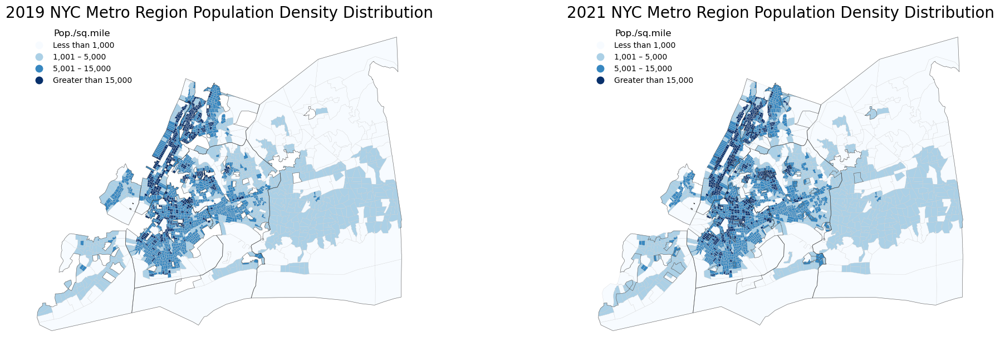

In [16]:
# Create subplots with adjusted aspect ratio and space between plots# Define bins and labels for population density categories
bins = [0, 1000, 5000, 15000, np.inf]
labels = ['< 1,000', '1,001 – 5,000', '5,001 – 15,000', '> 15,000']

# Create 'pop_density_category' column for 2019
acs19_gdf['pop_density_category'] = pd.cut(acs19_gdf['pop_density'], bins=bins, labels=labels, right=False)

# Create 'pop_density_category' column for 2021
acs21_gdf['pop_density_category'] = pd.cut(acs21_gdf['pop_density'], bins=bins, labels=labels, right=False)

# Create subplots with equal aspect ratio
fig, axes = plt.subplots(1, 2, figsize=(18, 8))

# Plot for 2019
plot19 = acs19_gdf.plot(column='pop_density_category', cmap='Blues', linewidth=0.2, ax=axes[0], edgecolor='0.8', legend=True)

#Add county boundaries to the map
counties_shape_gdf .plot(ax=axes[0], edgecolor='black', linewidth=0.5, alpha=0.5,facecolor='none')

# Customize the legend for 2019
legend_labels_19 = {'< 1,000': 'Less than 1,000', '1,001 – 5,000': '1,001 – 5,000', '5,001 – 15,000': '5,001 – 15,000', '> 15,000': 'Greater than 15,000'}
legend_19 = plot19.get_legend()
legend_19.set_title('Pop./sq.mile', prop={'size': 12})  # Add a title to the legend
for label, description in legend_labels_19.items():
    legend_19.get_texts()[labels.index(label)].set_text(description)

axes[0].set_title('2019 NYC Metro Region Population Density Distribution', fontdict={'fontsize': '20', 'fontweight': '3'})
axes[0].set_axis_off()


# Plot for 2021
plot21 = acs21_gdf.plot(column='pop_density_category', cmap='Blues', linewidth=0.2, ax=axes[1], edgecolor='0.8', legend=True)

#Add county boundaries to the map
counties_shape_gdf .plot(ax=axes[1], edgecolor='black', linewidth=0.5, alpha=0.5,facecolor='none')

# Customize the legend for 2021
legend_labels_21 = {'< 1,000': 'Less than 1,000', '1,001 – 5,000': '1,001 – 5,000', '5,001 – 15,000': '5,001 – 15,000', '> 15,000': 'Greater than 15,000'}
legend_21 = plot21.get_legend()
legend_21.set_title('Pop./sq.mile', prop={'size': 12})  # Add a title to the legend
for label, description in legend_labels_21.items():
    legend_21.get_texts()[labels.index(label)].set_text(description)

axes[1].set_title('2021 NYC Metro Region Population Density Distribution', fontdict={'fontsize': '20', 'fontweight': '3'})
axes[1].set_axis_off()

# Adjust layout with larger central map and space between plots
plt.subplots_adjust(left=0.02, right=0.98, wspace=0.4)

# Move legend to upper left for both plots
for ax in axes:
    legend = ax.get_legend()
    legend.set_bbox_to_anchor((0.3, 1))
    legend.get_frame().set_linewidth(0)  # Remove legend box boundaries
    legend.get_frame().set_alpha(0)  # Make legend background transparent
    
# Show the plot
plt.show()

 **Insight2: Looking at population density maps,  the  rapid population growth areas are Brooklyn, Queens and Staten Island.**

### 3. Looking at the Housing Value Trend prior and during Pandemic

In [17]:
# Convert '19 median housing value' and '21 median housing value' to numeric columns
acs19_gdf['19 median housing value'] = pd.to_numeric(acs19_gdf['19 median housing value'], errors='coerce')
acs21_gdf['21 median housing value'] = pd.to_numeric(acs21_gdf['21 median housing value'], errors='coerce')

# Define bins and labels for housing value categories
bins = [0, 500000, 650000, 800000, np.inf]
labels = ['< $500,000', '$500,000 – $650,000', '$650,000 – $800,000', '> $800,000']

# Create 'housing_value_category' column for 2019
acs19_gdf['housing_value_category'] = pd.cut(acs19_gdf['19 median housing value'], bins=bins, labels=labels, right=False)

# Create 'housing_value_category' column for 2021
acs21_gdf['housing_value_category'] = pd.cut(acs21_gdf['21 median housing value'], bins=bins, labels=labels, right=False)

# Convert 'housing_value_category' column values to strings
acs19_gdf['housing_value_category'] = acs19_gdf['housing_value_category'].astype(str)
acs21_gdf['housing_value_category'] = acs21_gdf['housing_value_category'].astype(str)

# Convert 'housing_value_category' column values to numeric
acs19_gdf['housing_value_category'] = pd.Categorical(acs19_gdf['housing_value_category'], categories=labels, ordered=True).codes
acs21_gdf['housing_value_category'] = pd.Categorical(acs21_gdf['housing_value_category'], categories=labels, ordered=True).codes

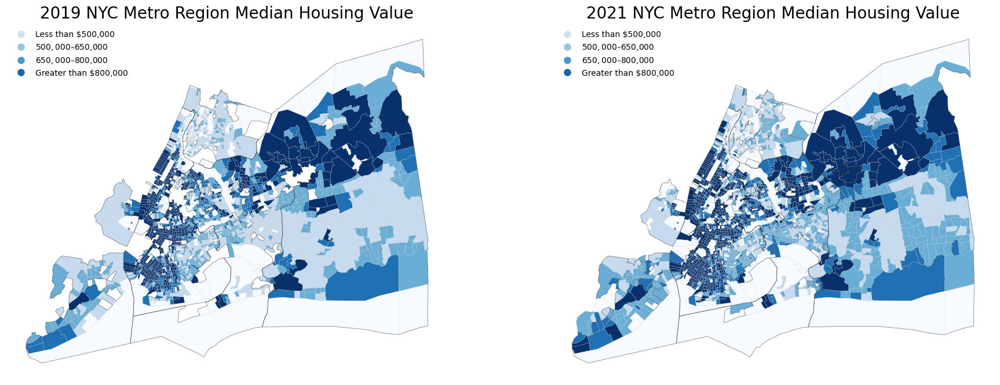

In [18]:
import matplotlib.patches as mpatches
import matplotlib.lines as mlines

# Create subplots with equal aspect ratio
fig, axes = plt.subplots(1, 2, figsize=(18, 8))

# Plot for 2019
plot19 = acs19_gdf.plot(column='housing_value_category', cmap='Blues', linewidth=0.2, ax=axes[0], edgecolor='0.8', legend=False)

# Add county boundaries to the map
counties_shape_gdf.plot(ax=axes[0], edgecolor='black', linewidth=0.5, alpha=0.5, facecolor='none')

# Customize the legend for 2021
legend_labels_19 = {'< $500,000': 'Less than $500,000', '$500,000 – $650,000': '$500,000 – $650,000', '$650,000 – $800,000': '$650,000 – $800,000', '> $800,000': 'Greater than $800,000'}

# Add legend for 2019
handles_19 = [mlines.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10, label=label) for label, color in zip(legend_labels_19.values(), sns.color_palette('Blues', len(legend_labels_19)))]
legend_19 = axes[0].legend(handles=handles_19, loc='upper left', bbox_to_anchor=(0, 1), frameon=False)

axes[0].set_title('2019 NYC Metro Region Median Housing Value', fontdict={'fontsize': '20', 'fontweight': '3'})
axes[0].set_axis_off()

# Plot for 2021
plot21 = acs21_gdf.plot(column='housing_value_category', cmap='Blues', linewidth=0.2, ax=axes[1], edgecolor='0.8', legend=False)

# Add county boundaries to the map
counties_shape_gdf.plot(ax=axes[1], edgecolor='black', linewidth=0.5, alpha=0.5, facecolor='none')

# Customize the legend for 2021
legend_labels_21 = {'< $500,000': 'Less than $500,000', '$500,000 – $650,000': '$500,000 – $650,000', '$650,000 – $800,000': '$650,000 – $800,000', '> $800,000': 'Greater than $800,000'}

# Add legend for 2021
handles_21 = [mlines.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10, label=label) for label, color in zip(legend_labels_21.values(), sns.color_palette('Blues', len(legend_labels_21)))]
legend_21 = axes[1].legend(handles=handles_21, loc='upper left', bbox_to_anchor=(0, 1), frameon=False)

axes[1].set_title('2021 NYC Metro Region Median Housing Value', fontdict={'fontsize': '20', 'fontweight': '3'})
axes[1].set_axis_off()

# Adjust layout with larger central map and space between plots
plt.subplots_adjust(left=0.02, right=0.98, wspace=0.2)

# Show the plot
plt.show()

 **Insight1: From  2019 to 2021, the housing prices rise across the entire NYC metro region, especially in Staten Island, Queens, Long Island and Brooklyne**

In [75]:
map_value_change_rate =acs_merge.hvplot(
    c="house_value_change_rate",
    geo=True,
    crs=2263,
    cmap="Blues",
    hover_cols=["house_value_change_rate"],
    dynamic=False,
    frame_width=600,
    frame_height=600,
    clim=(0,0.3), 
    # logz=True,  # Set log scale for color mapping
    line_width=0.1,  # Adjust line width for census tract borders
).opts(title="2019-2021 NYC Metro Region Median House Value Change Rate")
map_value_change_rate

:Polygons   [Longitude,Latitude]   (house_value_change_rate)

 **Insight2: However, looking at the housing prices change rate, South Long Island, Brooklyne, Jersey City, Queens increase the most.**

In [29]:
acs19_gdf_own_rate = acs19_gdf[['NAME', 'own_rate', '19 median housing value','geometry']].copy()
acs19_gdf_own_rate['own_rate'].fillna(0, inplace=True)
acs19_gdf_own_rate.head()

,NAME,own_rate,19 median housing value,geometry
0,"Census Tract 15.01, New York County, New York",0.527879,800100,"POLYGON ((981865.515 198455.903, 981935.654 19..."
1,"Census Tract 16, New York County, New York",0.057423,1200000,"POLYGON ((984941.947 199431.109, 985056.156 19..."
2,"Census Tract 18, New York County, New York",0.052649,794100,"POLYGON ((985796.223 201370.479, 985808.416 20..."
3,"Census Tract 20, New York County, New York",0.007486,-666666666,"POLYGON ((990149.045 201586.466, 990284.254 20..."
4,"Census Tract 22.01, New York County, New York",0.108417,236700,"POLYGON ((988552.924 201677.942, 988733.850 20..."


In [30]:
acs21_gdf_own_rate = acs21_gdf[['NAME', 'own_rate', '21 median housing value','geometry']].copy()
acs21_gdf_own_rate['own_rate'].fillna(0, inplace=True)
acs21_gdf_own_rate.head()

,NAME,own_rate,21 median housing value,geometry
0,"Census Tract 15.01, New York County, New York",0.583539,767300,"POLYGON ((981865.515 198455.903, 981935.654 19..."
1,"Census Tract 16, New York County, New York",0.158868,668200,"POLYGON ((984941.947 199431.109, 985056.156 19..."
2,"Census Tract 18, New York County, New York",0.095260,748100,"POLYGON ((985796.223 201370.479, 985808.416 20..."
3,"Census Tract 20, New York County, New York",0.012014,-666666666,"POLYGON ((990149.045 201586.466, 990284.254 20..."
4,"Census Tract 22.01, New York County, New York",0.129888,-666666666,"POLYGON ((988552.924 201677.942, 988733.850 20..."


In [34]:
# Create a Folium map centered around the mean of the geometry
m = acs19_gdf_own_rate.explore(
    column="own_rate", 
    cmap="Blues", 
    tiles="CartoDB positron", 
    vmin=0, 
    vmax=1,   
    style_kwds={
        "weight": 0.5, 
    }
)

# Add a title
title_html = '<h3 align="center" style="font-size:20px"><b>2019 NYC Metro Region Housing Ownership Rate</b></h3>'
m.get_root().html.add_child(folium.Element(title_html))

# Show the map
m

In [39]:
# Create a Folium map centered around the mean of the geometry
m = acs21_gdf_own_rate.explore(
    column="own_rate", 
    cmap="Blues",  
    tiles="CartoDB positron",  
    vmin=0, 
    vmax=1,   
    style_kwds={
        "weight": 0.5, 
    }
)

# Add a title
title_html = '<h3 align="center" style="font-size:20px"><b>2021 NYC Metro Region Housing Ownership Rate</b></h3>'
m.get_root().html.add_child(folium.Element(title_html))

# Show the map
m

 **Insight3: The closer the settlement is situated to the NYC metro region boundaries, the higher the proportion of owner-occupied housing is, which is somewhat related to the relatively low house values.**